# Importing Libraries
This notebook demonstrates the use of two different COVID-19 data sources for the U.S.
Set `data_source = 'usafacts'` if you'd like to pull data from https://usafacts.org.
Set `data_source = 'jhu_csse'` if you'd lke to use data from Johns Hopkins CSSE.

In [1]:
data_source = 'usafacts'

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
from fp_covid19.data.bears import Bears
if data_source == 'usafacts':
  from fp_covid19.data.usafacts import (
      get_covid19_us_bears, get_us_population, attribution)
elif data_source == 'jhu_csse':
  from fp_covid19.data.jhu_csse import (
      get_covid19_us_bears, get_us_population, attribution)
from fp_covid19.cases.compute import (
    new_cases, per_capita, check_cumulatives, to_epoch)
from fp_covid19.visualization.folium_helper import *
from fp_covid19.visualization.geojson_helper import (
  read_geo_pandas, USPS_PUB28_DF, US_NYC_FIPS)

# Convert CSV Files to `Bears` Objects
Let's convert the U.S. COVID-19 time-series CSV files to `Bears` objects. A `Bears` object has a Pandas `DataFrame` and properties that separate time-series columns from other columns.
As of 8 Apr., 2020, both Johns Hopkins and USAFacts host two U.S. CSV files with county-level data. One file is for confirmed cases and the other for deaths.
The function `get_covid19_us_bears()` computes state-level data from county-level data, returning four `Bears` objects in one dictionary.

In [3]:
country = 'US'
covid19 = {}
covid19[country] = get_covid19_us_bears()
for db_type, dicts in covid19[country].items():
  for geo_level, bears in dicts.items():
    display(db_type, geo_level, bears)

'confirmed'

'counties'

,Combined_Key,FIPS,Admin2,Province_State,stateFIPS,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
0,"Statewide Unallocated, AL",1000,Statewide Unallocated,Alabama,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,"Autauga County, AL",1001,Autauga County,Alabama,1,0,0,0,0,0,...,25,25,25,27,28,30,32,33,36,37
2,"Baldwin County, AL",1003,Baldwin County,Alabama,1,0,0,0,0,0,...,102,103,109,114,117,123,132,143,147,154
3,"Barbour County, AL",1005,Barbour County,Alabama,1,0,0,0,0,0,...,14,15,18,20,22,28,29,30,32,33
4,"Bibb County, AL",1007,Bibb County,Alabama,1,0,0,0,0,0,...,23,23,26,28,32,32,33,33,34,35
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3190,"Sweetwater County, WY",56037,Sweetwater County,Wyoming,56,0,0,0,0,0,...,10,10,10,10,10,10,10,10,10,10
3191,"Teton County, WY",56039,Teton County,Wyoming,56,0,0,0,0,0,...,59,61,62,62,62,62,63,63,64,64
3192,"Uinta County, WY",56041,Uinta County,Wyoming,56,0,0,0,0,0,...,4,6,6,6,6,6,6,6,6,6
3193,"Washakie County, WY",56043,Washakie County,Wyoming,56,0,0,0,0,0,...,5,5,5,5,5,5,5,5,5,5


'confirmed'

'states'

,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,1/27/2020,1/28/2020,1/29/2020,1/30/2020,1/31/2020,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
Province_State,,,,,,,,,,,,,,,,,,,,,
Alabama,0,0,0,0,0,0,0,0,0,0,...,4400,4515,4719,4897,5074,5317,5598,5825,6026,6213
Alaska,0,0,0,0,0,0,0,0,0,0,...,301,310,315,320,322,330,336,338,340,340
Arizona,0,0,0,0,1,1,1,1,1,1,...,4234,4507,4718,4928,5064,5251,5459,5768,6043,6280
Arkansas,0,0,0,0,0,0,0,0,0,0,...,1615,1690,1777,1780,1970,2261,2392,2599,2809,2909
California,0,0,0,0,2,3,3,4,4,4,...,28126,29420,30829,31591,33869,35814,37688,39556,41317,42566
Colorado,0,0,0,0,0,0,0,0,0,0,...,8675,9046,9432,9729,10106,10446,10877,11188,12179,12894
Connecticut,0,0,0,0,0,0,0,0,0,0,...,15884,16809,17550,17962,19815,20360,22469,23100,23921,24582
Delaware,0,0,0,0,0,0,0,0,0,0,...,2075,2323,2538,2538,2745,2931,3200,3308,3442,3576
District of Columbia,0,0,0,0,0,0,0,0,0,0,...,2350,2476,2666,2793,2927,3098,3206,3361,3528,3699


'deaths'

'counties'

,Combined_Key,FIPS,Admin2,Province_State,stateFIPS,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
0,"Statewide Unallocated, AL",1000,Statewide Unallocated,Alabama,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,"Autauga County, AL",1001,Autauga County,Alabama,1,0,0,0,0,0,...,1,1,1,1,1,1,1,2,2,2
2,"Baldwin County, AL",1003,Baldwin County,Alabama,1,0,0,0,0,0,...,0,0,1,1,1,3,3,3,3,3
3,"Barbour County, AL",1005,Barbour County,Alabama,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,"Bibb County, AL",1007,Bibb County,Alabama,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3190,"Sweetwater County, WY",56037,Sweetwater County,Wyoming,56,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3191,"Teton County, WY",56039,Teton County,Wyoming,56,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3192,"Uinta County, WY",56041,Uinta County,Wyoming,56,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3193,"Washakie County, WY",56043,Washakie County,Wyoming,56,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


'deaths'

'states'

,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,1/27/2020,1/28/2020,1/29/2020,1/30/2020,1/31/2020,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
Province_State,,,,,,,,,,,,,,,,,,,,,
Alabama,0,0,0,0,0,0,0,0,0,0,...,82,96,110,112,112,142,176,197,209,213
Alaska,0,0,0,0,0,0,0,0,0,0,...,9,9,9,9,9,9,9,9,9,9
Arizona,0,0,0,0,0,0,0,0,0,0,...,150,169,177,184,187,208,228,249,266,273
Arkansas,0,0,0,0,0,0,0,0,0,0,...,37,37,38,39,42,43,44,45,47,48
California,0,0,0,0,0,0,0,0,0,0,...,973,1013,1149,1179,1226,1319,1432,1529,1614,1693
Colorado,0,0,0,0,0,0,0,0,0,0,...,374,391,411,422,449,486,508,550,672,670
Connecticut,0,0,0,0,0,0,0,0,0,0,...,971,1036,1086,1127,1331,1423,1544,1639,1764,1862
Delaware,0,0,0,0,0,0,0,0,0,0,...,52,61,67,67,72,82,89,92,100,112
District of Columbia,0,0,0,0,0,0,0,0,0,0,...,81,86,91,96,105,112,127,139,153,165


# Quick Sanity Checks
The cumulative data are often not exactly cumulative.

In [4]:
not_monotonic_increasing_index, not_exactly_cumulatives = check_cumulatives(covid19[country])
display('Non-monotonically increasing data points', not_exactly_cumulatives.style.format('{:.2%}'))

'Non-monotonically increasing data points'

,Confirmed,Deaths
Counties (3195 items),13.27%,3.97%
States (51 items),15.69%,23.53%


# Total U.S. Cases

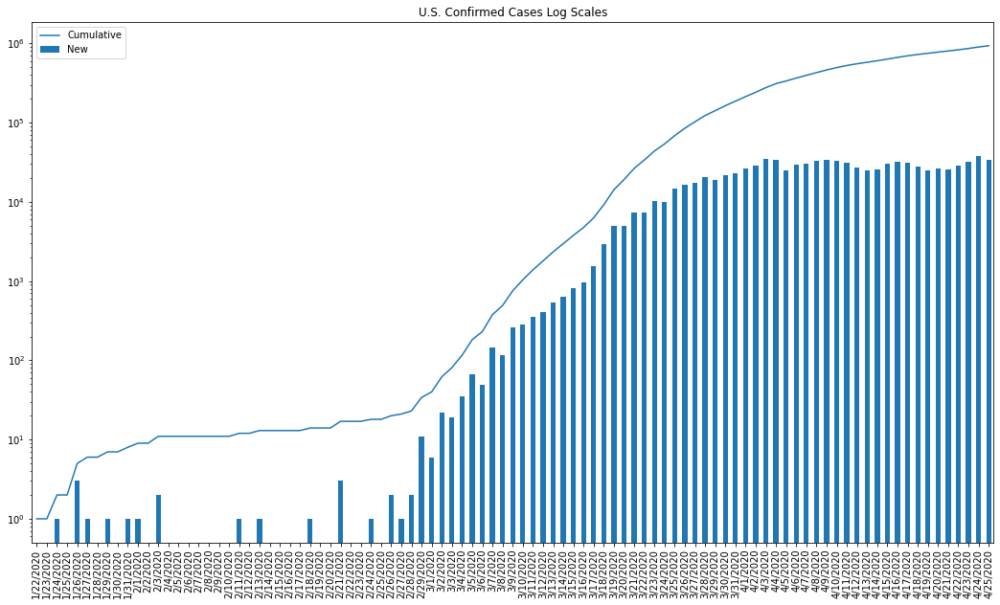

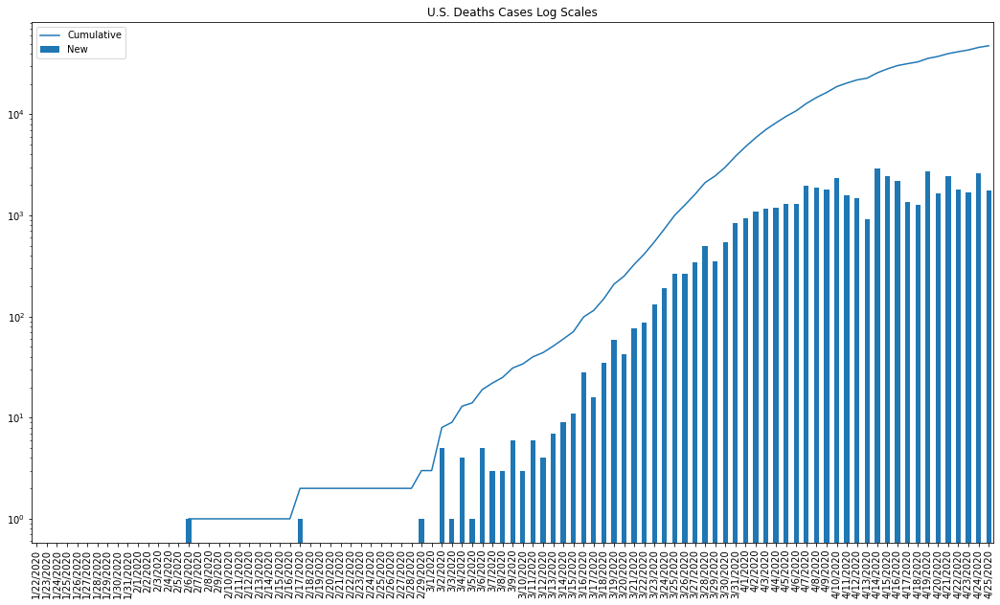

In [5]:
logy = True
db_types = ['confirmed', 'deaths']
for db_type in db_types: 
  bears = covid19[country][db_type]['states']
  series = bears.df.sum()
  series_diff = series[bears.datetime_index].diff()
  ax = series.plot(
      title=('U.S. {db_type} {scale}'
             .format(
                 db_type=db_type.capitalize(),
                 scale='Log Scales' if logy else '')),
      logy=logy,)
  series_diff.plot.bar(
      title=('U.S. {db_type} Cases {scale}'
             .format(
                 db_type=db_type.capitalize(),
                 scale='Log Scales' if logy else '')),
      logy=logy,
      figsize=[18, 10],
      ax=ax
  )
  ax.legend(['Cumulative', 'New'])
  plt.show()

#  Cumulative and New Cases for U.S. States and Counties

Review the top $k$ confrimed and death cases by county and by state. Plot *cumulative* confirmed cases as lines and *new* cases as bars on a log scale. Use the new-case bar chart to see whether the curve is rising exponentially, getting flat, or declining. From the new-case chart, we do not want to see a new wave of infections.

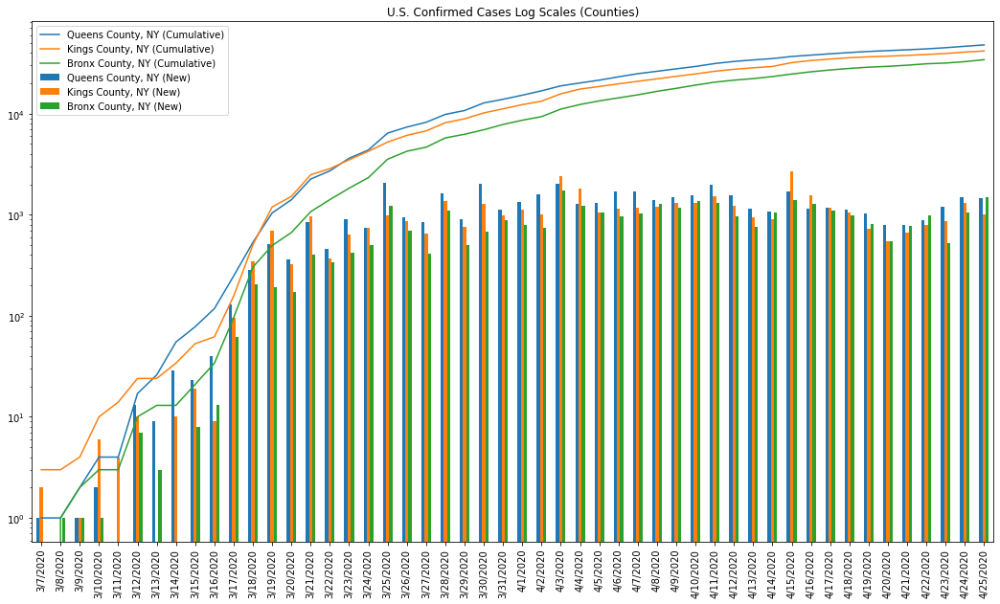

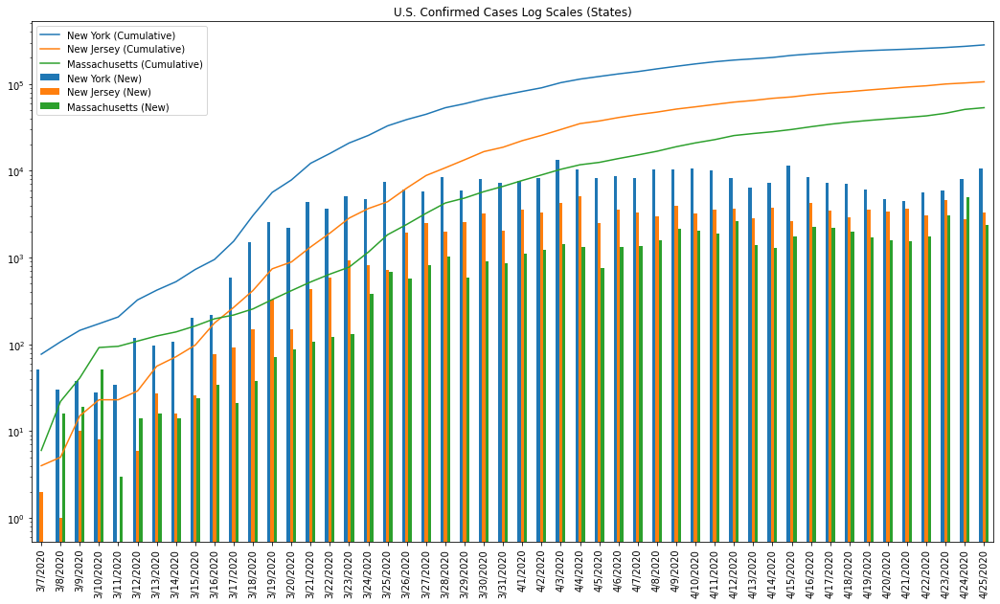

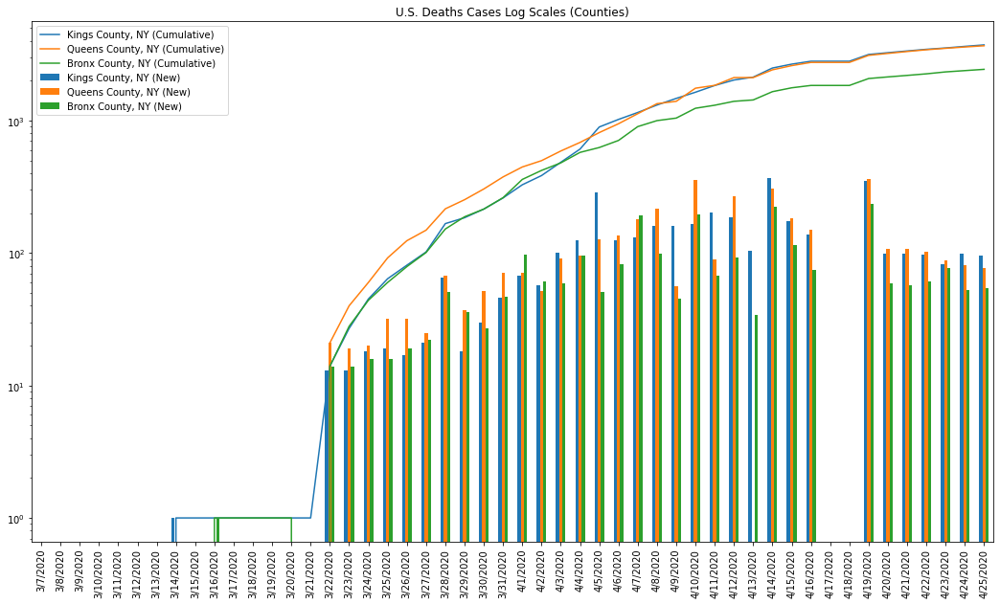

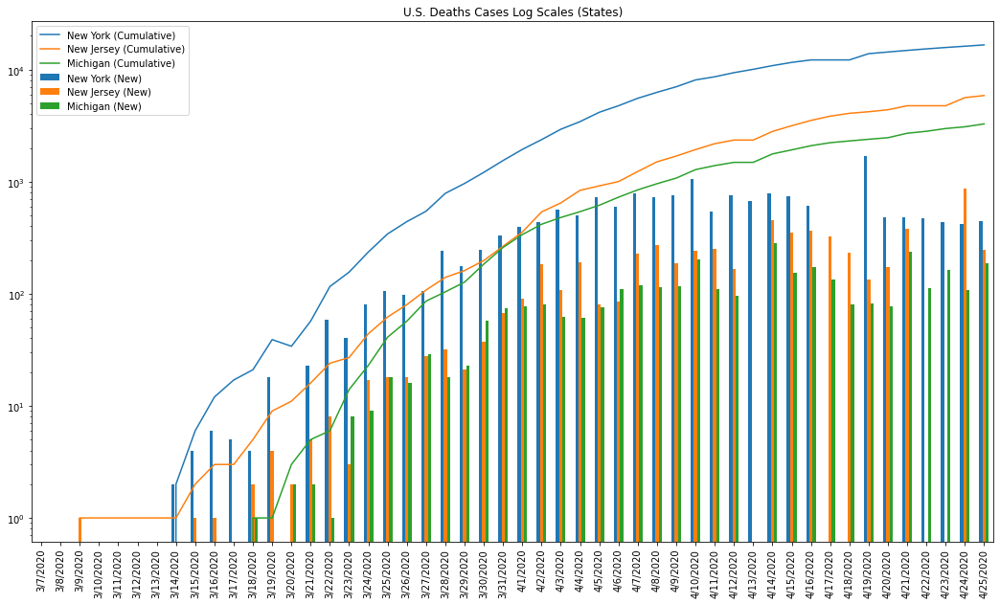

In [6]:
top_k = 3
period = 50
logy = True
for db_type, dicts in covid19[country].items():
  for geo_level, bears in dicts.items():
    top_k_bears = Bears(
        dataframe=bears.df.nlargest(top_k, bears.df.columns[-1]))
    df = top_k_bears.df
    df_diff = new_cases(top_k_bears).df
    if geo_level == 'counties':
      df = df.set_index(['Admin2', 'Province_State'])
      df_diff = df_diff.set_index(['Admin2', 'Province_State'])
    ax = df[df.columns[-period:]].T.plot(
        logy=logy,
        figsize=[18, 10],)
    ax = df_diff[df.columns[-period:]].T.plot.bar(
        title=('U.S. {db_type} Cases {scale} ({geo_level})'
               .format(
                   db_type=db_type.capitalize(),
                   scale='Log Scales' if logy else '',
                   geo_level=geo_level.capitalize())
              ),
        logy=logy,
        ax=ax,
    )
    legend_labels = (df.Combined_Key.values if geo_level == 'counties'
                     else df.index.values)
    ax.legend(list(legend_labels + ' (Cumulative)') + 
              list(legend_labels + ' (New)'))

# Download County Populations and Derive State Populations

In [7]:
population = get_us_population()
display(population['counties'].head())

,FIPS,Admin2,Province_State,Population
0,0,Statewide Unallocated,Alabama,0
1,1001,Autauga County,Alabama,55869
2,1003,Baldwin County,Alabama,223234
3,1005,Barbour County,Alabama,24686
4,1007,Bibb County,Alabama,22394


In [8]:
display(population['states'].sort_values(by='Population', ascending=False).head())

,Population,Province_State
index,,
California,39512223,California
Texas,28995881,Texas
Florida,21477737,Florida
New York,19453561,New York
Pennsylvania,12801989,Pennsylvania


# Cases Per Capita

In [9]:
covid19_per_capita = {
    'US': #TODO: recovered and deaths not implemented
    {'confirmed': {'counties': None, 'states': None},
     'deaths': {'counties': None, 'states': None}}}

top_k = 5
for db_type in ['confirmed', 'deaths']:
  for geo_level in ['states', 'counties']:
    covid19_per_capita[country][db_type][geo_level] = per_capita(
        covid19[country][db_type][geo_level],
        population[geo_level]['Population'])
    display('Top-{} Per Capita {} ({})'.format(
        top_k, db_type.capitalize(), geo_level.capitalize()),
        covid19_per_capita[country][db_type][geo_level].df.nlargest(
            top_k, covid19_per_capita[country][db_type][geo_level].datetime_index[-1]))

'Top-5 Per Capita Confirmed (States)'

,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,1/27/2020,1/28/2020,1/29/2020,1/30/2020,1/31/2020,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
Province_State,,,,,,,,,,,,,,,,,,,,,
New York,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.011426,0.011805,0.012169,0.012480,0.012723,0.012952,0.013242,0.013547,0.013964,0.014507
New Jersey,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.008480,0.008871,0.009200,0.009604,0.009989,0.010400,0.010742,0.011257,0.011571,0.011942
Massachusetts,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.004669,0.004991,0.005277,0.005524,0.005752,0.005977,0.006231,0.006677,0.007395,0.007740
Connecticut,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.004455,0.004715,0.004922,0.005038,0.005558,0.005711,0.006302,0.006479,0.006709,0.006895
Rhode Island,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.003623,0.003943,0.004239,0.004443,0.004805,0.005061,0.005514,0.005847,0.006146,0.006490


'Top-5 Per Capita Confirmed (Counties)'

,Combined_Key,FIPS,Admin2,Province_State,stateFIPS,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
155,"Lincoln County, AR",5079,Lincoln County,Arkansas,5,0.0,0.0,0.0,0.0,0.0,...,0.004684,0.007217,0.008523,0.008523,0.019810,0.034014,0.039312,0.048372,0.054284,0.055359
2476,"Bledsoe County, TN",47007,Bledsoe County,Tennessee,47,0.0,0.0,0.0,0.0,0.0,...,0.000465,0.000531,0.000597,0.000597,0.000664,0.000730,0.005975,0.023301,0.038834,0.038901
1906,"Rockland County, NY",36087,Rockland County,New York,36,0.0,0.0,0.0,0.0,0.0,...,0.026864,0.027585,0.028150,0.028743,0.029028,0.029369,0.029771,0.030167,0.030974,0.034044
2131,"Marion County, OH",39101,Marion County,Ohio,39,0.0,0.0,0.0,0.0,0.0,...,0.004240,0.006575,0.015101,0.028175,0.031847,0.032753,0.032830,0.033199,0.033322,0.033368
2145,"Pickaway County, OH",39129,Pickaway County,Ohio,39,0.0,0.0,0.0,0.0,0.0,...,0.003353,0.004328,0.005166,0.008160,0.021315,0.027969,0.028363,0.028380,0.028380,0.028431


'Top-5 Per Capita Deaths (States)'

,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,1/27/2020,1/28/2020,1/29/2020,1/30/2020,1/31/2020,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
Province_State,,,,,,,,,,,,,,,,,,,,,
New York,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000627,0.000627,0.000627,0.000713,0.000737,0.000762,0.000786,0.000809,0.000831,0.000853
New Jersey,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000396,0.000432,0.000458,0.000473,0.000493,0.000535,0.000535,0.000535,0.000633,0.000660
Connecticut,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000272,0.000291,0.000305,0.000316,0.000373,0.000399,0.000433,0.000460,0.000495,0.000522
Massachusetts,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000181,0.000204,0.000226,0.000247,0.000262,0.000285,0.000317,0.000342,0.000371,0.000396
Louisiana,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000249,0.000261,0.000273,0.000279,0.000286,0.000302,0.000317,0.000331,0.000344,0.000354


'Top-5 Per Capita Deaths (Counties)'

,Combined_Key,FIPS,Admin2,Province_State,stateFIPS,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
518,"Randolph County, GA",13243,Randolph County,Georgia,13,0.0,0.0,0.0,0.0,0.0,...,0.001623,0.001770,0.001918,0.001918,0.002213,0.002361,0.002508,0.002656,0.002656,0.002803
533,"Terrell County, GA",13273,Terrell County,Georgia,13,0.0,0.0,0.0,0.0,0.0,...,0.001407,0.001641,0.001641,0.001641,0.002110,0.002110,0.002110,0.002110,0.001993,0.001993
1865,"Bronx County, NY",36005,Bronx County,New York,36,0.0,0.0,0.0,0.0,0.0,...,0.001301,0.001301,0.001301,0.001467,0.001509,0.001549,0.001592,0.001646,0.001684,0.001722
1903,"Queens County, NY",36081,Queens County,New York,36,0.0,0.0,0.0,0.0,0.0,...,0.001222,0.001222,0.001222,0.001382,0.001429,0.001477,0.001523,0.001562,0.001598,0.001632
1180,"St. John the Baptist Parish, LA",22095,St. John the Baptist Parish,Louisiana,22,0.0,0.0,0.0,0.0,0.0,...,0.001097,0.001167,0.001237,0.001237,0.001237,0.001331,0.001331,0.001377,0.001471,0.001494


In [10]:
us_population = population['states']['Population'].sum()
display(us_population)

328239523

# Convert county borders from GeoJSON file to GeoPandas

In [11]:
import geopandas as gpd

In [12]:
covid19_gdf = {country: {}}
covid19_gdf[country] = read_geo_pandas()

In [13]:
covid19_gdf[country]['counties']['tmp_stateFIPS'] = (
    covid19_gdf[country]['counties']
    .id.str[:-3])
covid19_gdf[country]['counties'] = (
    covid19_gdf[country]['counties'].merge(
        left_on='tmp_stateFIPS',
        right=USPS_PUB28_DF[['stateFIPS', 'USPS', 'Province_State']],
        right_on='stateFIPS')).drop('tmp_stateFIPS', axis='columns')
covid19_gdf[country]['counties'].loc[:, 'Combined_Key'] = (
    covid19_gdf[country]['counties']['name']
    .combine(
        covid19_gdf[country]['counties']['Province_State'],
        lambda s1, s2: s1 + ', ' + s2))
covid19_gdf[country]['counties'].loc[:, 'id2'] = covid19_gdf[country]['counties'].id.copy().str.lstrip('0')
covid19_gdf[country]['counties'].set_index('id2', inplace=True)


covid19_gdf[country]['states'].id = covid19_gdf[country]['states'].id.str.lstrip('0')
covid19_gdf[country]['states']['id2'] = covid19_gdf[country]['states'].id.copy().str.lstrip('0')
covid19_gdf[country]['states'].set_index('id2', inplace=True)
covid19_gdf[country]['states'].index = covid19_gdf[country]['states'].index.map(str)
covid19_gdf[country]['states']['Combined_Key'] = covid19_gdf[country]['states']['name'].copy()

In [14]:
display(covid19_gdf['US']['states'].head(), covid19_gdf['US']['counties'].head())

,id,name,geometry,Combined_Key
id2,,,,
1,1,Alabama,"POLYGON ((-87.35930 35.00118, -85.60667 34.984...",Alabama
2,2,Alaska,"MULTIPOLYGON (((-131.60202 55.11798, -131.5691...",Alaska
4,4,Arizona,"POLYGON ((-109.04250 37.00026, -109.04798 31.3...",Arizona
5,5,Arkansas,"POLYGON ((-94.47384 36.50186, -90.15254 36.496...",Arkansas
6,6,California,"POLYGON ((-123.23326 42.00619, -122.37885 42.0...",California


,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State,Combined_Key
id2,,,,,,,,,
1017,1017,Chambers,1017,1562.057367,"POLYGON ((-85.59318 33.10734, -85.51975 33.108...",1,AL,Alabama,"Chambers, Alabama"
1013,1013,Butler,1013,2014.703850,"POLYGON ((-86.90590 31.75304, -86.90690 31.830...",1,AL,Alabama,"Butler, Alabama"
1019,1019,Cherokee,1019,1553.931854,"POLYGON ((-85.84362 34.20001, -85.84380 34.244...",1,AL,Alabama,"Cherokee, Alabama"
1063,1063,Greene,1063,1709.198324,"POLYGON ((-88.17185 32.99586, -88.16286 33.015...",1,AL,Alabama,"Greene, Alabama"
1065,1065,Hale,1065,1700.330587,"POLYGON ((-87.71571 33.00682, -87.62041 33.004...",1,AL,Alabama,"Hale, Alabama"


# Any FIPS missing from the GeoJSON?

In [15]:
counties_gdf = covid19_gdf[country]['counties']
covid19_counties_df = covid19['US']['confirmed']['counties'].df
# Filter out FIPS that end with '000' since they refer to unallocated regions
display('counties_gdf.index.str.endswith("000"):',  counties_gdf[counties_gdf.index.str.endswith('000')])
display('covid19_counties_df.FIPS.str.endswith("000"):', covid19_counties_df.FIPS.str.endswith('000'))
display('covid19_counties_df first entry:', covid19_counties_df.FIPS.head(2).str.endswith('000'))
fips_in_geojson_but_not_covid19 = counties_gdf.loc[
    ~counties_gdf.index.isin(covid19_counties_df.FIPS)]
fips_in_covid19_but_not_geojson = covid19_counties_df.loc[
    ~covid19_counties_df.FIPS.isin(counties_gdf.index)]
display('FIPS in GeoJSON but not COVID-19 dataframe: ',
        len(fips_in_geojson_but_not_covid19),
        fips_in_geojson_but_not_covid19)
with pd.option_context("display.max_rows", 1000):
    display('FIPS in COVID-19 dataframe but not GeoJSON: ',
        len(fips_in_covid19_but_not_geojson),
        fips_in_covid19_but_not_geojson.query('Admin2 != "Statewide Unallocated"'))

'counties_gdf.index.str.endswith("000"):'

,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State,Combined_Key
id2,,,,,,,,,


'covid19_counties_df.FIPS.str.endswith("000"):'

0         NaN
1       False
2       False
3       False
4       False
        ...  
3190    False
3191    False
3192    False
3193    False
3194    False
Name: FIPS, Length: 3195, dtype: object

'covid19_counties_df first entry:'

0      NaN
1    False
Name: FIPS, dtype: object

'FIPS in GeoJSON but not COVID-19 dataframe: '

86

,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State,Combined_Key
id2,,,,,,,,,
60010,60010,Eastern,60010,414.849074,"POLYGON ((-170.66633 -14.37578, -170.73215 -14...",60,AS,American Samoa,"Eastern, American Samoa"
60050,60050,Western,60050,269.226443,"POLYGON ((-170.79716 -14.24664, -170.73215 -14...",60,AS,American Samoa,"Western, American Samoa"
60040,60040,Swains Island,60040,151.603068,"POLYGON ((-171.14118 -11.04661, -171.13745 -11...",60,AS,American Samoa,"Swains Island, American Samoa"
60030,60030,Rose Island,60030,147.465895,"POLYGON ((-168.22527 -14.53591, -168.21848 -14...",60,AS,American Samoa,"Rose Island, American Samoa"
60020,60020,Manu'a,60020,521.858986,"POLYGON ((-169.63135 -14.22797, -169.66061 -14...",60,AS,American Samoa,"Manu'a, American Samoa"
...,...,...,...,...,...,...,...,...,...
72054,72054,Florida,72054,39.425511,"POLYGON ((-66.58818 18.38941, -66.56431 18.413...",72,PR,Puerto Rico,"Florida, Puerto Rico"
72101,72101,Morovis,72101,100.815705,"POLYGON ((-66.46321 18.37147, -66.44380 18.371...",72,PR,Puerto Rico,"Morovis, Puerto Rico"
78030,78030,St. Thomas,78030,799.030793,"POLYGON ((-64.84373 18.39371, -64.84371 18.349...",78,VI,U.S. Virgin Islands,"St. Thomas, U.S. Virgin Islands"


'FIPS in COVID-19 dataframe but not GeoJSON: '

53

,Combined_Key,FIPS,Admin2,Province_State,stateFIPS,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
95,"Wade Hampton Census Area, AK",2270,Wade Hampton Census Area,Alaska,2,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
192,"Grand Princess Cruise Ship, CA",6000,Grand Princess Cruise Ship,California,6,0,0,0,0,0,...,21,21,21,21,21,21,21,21,21,21
1862,"New York City Unallocated/Probable, NY",1,New York City Unallocated/Probable,New York,36,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


# New York City

Some databases do not break out data for the five boroughs in New York City and instead assign their cases to New York County (Manhattan).
The five FIPS for New York City are in the list `US_NYC_FIPS`.
+ Bronx
+ Kings (Brooklyn), 
+ New York (Manhattan), 
+ Queens,
+ Richmond (Staten Island)

In [16]:
counties_gdf[counties_gdf.index.isin(US_NYC_FIPS)]

,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State,Combined_Key
id2,,,,,,,,,
36047,36047,Kings,36047,250.770442,"POLYGON ((-74.05574 40.65176, -74.03457 40.684...",36,NY,New York,"Kings, New York"
36005,36005,Bronx,36005,148.597465,"POLYGON ((-73.91791 40.91758, -73.83841 40.894...",36,NY,New York,"Bronx, New York"
36061,36061,New York,36061,87.232257,"POLYGON ((-73.98479 40.79769, -73.96318 40.826...",36,NY,New York,"New York, New York"
36085,36085,Richmond,36085,264.925366,"POLYGON ((-74.20369 40.59269, -74.20225 40.630...",36,NY,New York,"Richmond, New York"
36081,36081,Queens,36081,461.099600,"POLYGON ((-74.03629 40.55104, -73.87922 40.574...",36,NY,New York,"Queens, New York"


In [17]:
for db_type in ['confirmed', 'deaths']:
  display(
      db_type,
      covid19['US'][db_type]['counties'].df[
        covid19['US'][db_type]['counties'].df.FIPS.isin(US_NYC_FIPS)
      ])

'confirmed'

,Combined_Key,FIPS,Admin2,Province_State,stateFIPS,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
1865,"Bronx County, NY",36005,Bronx County,New York,36,0,0,0,0,0,...,25932,27035,28019,28823,29372,30142,31130,31659,32701,34183
1886,"Kings County, NY",36047,Kings County,New York,36,0,0,0,0,0,...,33521,34705,35763,36482,37030,37694,38481,39354,40648,41660
1893,"New York County, NY",36061,New York County,New York,36,0,0,0,0,0,...,17091,17490,17932,18220,18468,18699,19025,19348,19854,20280
1903,"Queens County, NY",36081,Queens County,New York,36,0,0,0,0,0,...,37918,39091,40216,41237,42023,42822,43713,44904,46387,47861
1905,"Richmond County, NY",36085,Richmond County,New York,36,0,0,0,0,0,...,8684,9031,9333,9674,9913,10166,10405,10590,10883,11129


'deaths'

,Combined_Key,FIPS,Admin2,Province_State,stateFIPS,1/22/2020,1/23/2020,1/24/2020,1/25/2020,1/26/2020,...,4/16/2020,4/17/2020,4/18/2020,4/19/2020,4/20/2020,4/21/2020,4/22/2020,4/23/2020,4/24/2020,4/25/2020
1865,"Bronx County, NY",36005,Bronx County,New York,36,0,0,0,0,0,...,1845,1845,1845,2081,2140,2197,2258,2335,2388,2442
1886,"Kings County, NY",36047,Kings County,New York,36,0,0,0,0,0,...,2811,2811,2811,3162,3261,3360,3458,3540,3639,3734
1893,"New York County, NY",36061,New York County,New York,36,0,0,0,0,0,...,1070,1070,1070,1207,1252,1289,1337,1366,1366,1439
1903,"Queens County, NY",36081,Queens County,New York,36,0,0,0,0,0,...,2754,2754,2754,3114,3221,3329,3432,3520,3601,3678
1905,"Richmond County, NY",36085,Richmond County,New York,36,0,0,0,0,0,...,413,413,413,458,470,482,492,506,511,524


# Build Folium ToolTip for Choropleths

In [18]:
counties_with_covid_gdf = counties_gdf
# Merge confirmed and death cases, count and per capita
for db_type in ['confirmed', 'deaths']:
  for right_bear in [covid19[country][db_type]['counties'], 
                     covid19_per_capita[country][db_type]['counties']]:
    counties_with_covid_gdf = (pd.merge(
        left=counties_with_covid_gdf,
        left_on='id',
        right=right_bear.df.loc[
            :, ['FIPS', right_bear.datetime_index[-1]]],
        right_on='FIPS')
        .drop(columns='FIPS')
        .rename(columns={
            right_bear.datetime_index[-1]: db_type + (
                '_per_capita'
                if right_bear == covid19_per_capita[country][db_type]['counties']
                else '')}))
# Merge population
counties_with_covid_gdf = (
  pd.merge(
      left=counties_with_covid_gdf,
      left_on='id',
      right=population['counties'],
      right_on='FIPS')
  .drop(columns='FIPS')
)

# Read https://www.medrxiv.org/content/10.1101/2020.02.19.20025163v1.full.pdf and
# https://wwwnc.cdc.gov/eid/article/26/6/20-0320_article first before calling anything
# case fatality rate.
#counties_with_covid_gdf = counties_with_covid_gdf.assign(
#   case_fatality_rate=lambda x: x.deaths/x.confirmed)


In [19]:
counties_with_covid_gdf.head()

,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State_x,Combined_Key,confirmed,confirmed_per_capita,deaths,deaths_per_capita,Admin2,Province_State_y,Population
0,1017,Chambers,1017,1562.057367,"POLYGON ((-85.59318 33.10734, -85.51975 33.108...",1,AL,Alabama,"Chambers, Alabama",284,0.008540,18,0.000541,Chambers County,Alabama,33254
1,1013,Butler,1013,2014.703850,"POLYGON ((-86.90590 31.75304, -86.90690 31.830...",1,AL,Alabama,"Butler, Alabama",28,0.001440,0,0.000000,Butler County,Alabama,19448
2,1019,Cherokee,1019,1553.931854,"POLYGON ((-85.84362 34.20001, -85.84380 34.244...",1,AL,Alabama,"Cherokee, Alabama",12,0.000458,0,0.000000,Cherokee County,Alabama,26196
3,1063,Greene,1063,1709.198324,"POLYGON ((-88.17185 32.99586, -88.16286 33.015...",1,AL,Alabama,"Greene, Alabama",44,0.005425,0,0.000000,Greene County,Alabama,8111
4,1065,Hale,1065,1700.330587,"POLYGON ((-87.71571 33.00682, -87.62041 33.004...",1,AL,Alabama,"Hale, Alabama",40,0.002730,2,0.000137,Hale County,Alabama,14651


In [20]:
counties_with_covid_gdf.query('confirmed > 100').nlargest(5, 'deaths_per_capita')

,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State_x,Combined_Key,confirmed,confirmed_per_capita,deaths,deaths_per_capita,Admin2,Province_State_y,Population
403,13243,Randolph,13243,1115.956364,"POLYGON ((-84.90701 31.92447, -84.65582 31.920...",13,GA,Georgia,"Randolph, Georgia",153,0.022573,19,0.002803,Randolph County,Georgia,6778
498,13273,Terrell,13273,874.647141,"POLYGON ((-84.59978 31.92017, -84.45331 31.919...",13,GA,Georgia,"Terrell, Georgia",165,0.019341,17,0.001993,Terrell County,Georgia,8531
1854,36005,Bronx,36005,148.597465,"POLYGON ((-73.91791 40.91758, -73.83841 40.894...",36,NY,New York,"Bronx, New York",34183,0.024103,2442,0.001722,Bronx County,New York,1418207
1869,36081,Queens,36081,461.099600,"POLYGON ((-74.03629 40.55104, -73.87922 40.574...",36,NY,New York,"Queens, New York",47861,0.021235,3678,0.001632,Queens County,New York,2253858
1175,22095,St. John the Baptist,22095,1061.525200,"POLYGON ((-90.64200 30.16643, -90.63281 30.221...",22,LA,Louisiana,"St. John the Baptist, Louisiana",747,0.017438,64,0.001494,St. John the Baptist Parish,Louisiana,42837


For easier printing in tooltips. Combine absolute and per-capita fields. Convert per-capita data to perecentages as strings.

In [21]:
counties_with_covid_tooltip_gdf = (counties_with_covid_gdf.
 assign(
    confirmed_per_capita=lambda x: x.confirmed_per_capita.apply(
          lambda y: '{:.3%}'.format(y)),
    deaths_per_capita=lambda x: x.deaths_per_capita.apply(
          lambda y: '{:.3%}'.format(y))
 )
)
counties_with_covid_tooltip_gdf

,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State_x,Combined_Key,confirmed,confirmed_per_capita,deaths,deaths_per_capita,Admin2,Province_State_y,Population
0,1017,Chambers,1017,1562.057367,"POLYGON ((-85.59318 33.10734, -85.51975 33.108...",1,AL,Alabama,"Chambers, Alabama",284,0.854%,18,0.054%,Chambers County,Alabama,33254
1,1013,Butler,1013,2014.703850,"POLYGON ((-86.90590 31.75304, -86.90690 31.830...",1,AL,Alabama,"Butler, Alabama",28,0.144%,0,0.000%,Butler County,Alabama,19448
2,1019,Cherokee,1019,1553.931854,"POLYGON ((-85.84362 34.20001, -85.84380 34.244...",1,AL,Alabama,"Cherokee, Alabama",12,0.046%,0,0.000%,Cherokee County,Alabama,26196
3,1063,Greene,1063,1709.198324,"POLYGON ((-88.17185 32.99586, -88.16286 33.015...",1,AL,Alabama,"Greene, Alabama",44,0.542%,0,0.000%,Greene County,Alabama,8111
4,1065,Hale,1065,1700.330587,"POLYGON ((-87.71571 33.00682, -87.62041 33.004...",1,AL,Alabama,"Hale, Alabama",40,0.273%,2,0.014%,Hale County,Alabama,14651
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3137,56011,Crook,56011,7421.255025,"POLYGON ((-105.07660 44.99993, -105.03825 45.0...",56,WY,Wyoming,"Crook, Wyoming",5,0.066%,0,0.000%,Crook County,Wyoming,7584
3138,56045,Weston,56045,6216.029978,"POLYGON ((-105.07928 44.17618, -104.72288 44.1...",56,WY,Wyoming,"Weston, Wyoming",0,0.000%,0,0.000%,Weston County,Wyoming,6927
3139,56017,Hot Springs,56017,5196.555110,"POLYGON ((-109.31295 43.81329, -109.27255 43.8...",56,WY,Wyoming,"Hot Springs, Wyoming",1,0.023%,0,0.000%,Hot Springs County,Wyoming,4413
3140,56009,Converse,56009,11046.455496,"POLYGON ((-106.07340 42.43324, -106.07585 42.4...",56,WY,Wyoming,"Converse, Wyoming",10,0.072%,0,0.000%,Converse County,Wyoming,13822


In [22]:
counties_with_covid_tooltip_gdf = (counties_with_covid_tooltip_gdf.assign(
    confirmed_str=counties_with_covid_tooltip_gdf.confirmed.combine(
        counties_with_covid_tooltip_gdf.confirmed_per_capita,
        lambda series1, series2: np.nan_to_num(series1).astype(int).astype(str) + ' (' + series2 + ')'
    ),
    deaths_str=counties_with_covid_tooltip_gdf.deaths.combine(
        counties_with_covid_tooltip_gdf.deaths_per_capita,
        lambda series1, series2: np.nan_to_num(series1).astype(int).astype(str) + ' (' + series2 + ')'
    )
 )
 .drop(columns=['confirmed', 'confirmed_per_capita', 'deaths', 'deaths_per_capita'])
)

In [23]:
counties_with_covid_tooltip_gdf

,id,name,StCo_FIPSC,AreaSqKM,geometry,stateFIPS,USPS,Province_State_x,Combined_Key,Admin2,Province_State_y,Population,confirmed_str,deaths_str
0,1017,Chambers,1017,1562.057367,"POLYGON ((-85.59318 33.10734, -85.51975 33.108...",1,AL,Alabama,"Chambers, Alabama",Chambers County,Alabama,33254,284 (0.854%),18 (0.054%)
1,1013,Butler,1013,2014.703850,"POLYGON ((-86.90590 31.75304, -86.90690 31.830...",1,AL,Alabama,"Butler, Alabama",Butler County,Alabama,19448,28 (0.144%),0 (0.000%)
2,1019,Cherokee,1019,1553.931854,"POLYGON ((-85.84362 34.20001, -85.84380 34.244...",1,AL,Alabama,"Cherokee, Alabama",Cherokee County,Alabama,26196,12 (0.046%),0 (0.000%)
3,1063,Greene,1063,1709.198324,"POLYGON ((-88.17185 32.99586, -88.16286 33.015...",1,AL,Alabama,"Greene, Alabama",Greene County,Alabama,8111,44 (0.542%),0 (0.000%)
4,1065,Hale,1065,1700.330587,"POLYGON ((-87.71571 33.00682, -87.62041 33.004...",1,AL,Alabama,"Hale, Alabama",Hale County,Alabama,14651,40 (0.273%),2 (0.014%)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3137,56011,Crook,56011,7421.255025,"POLYGON ((-105.07660 44.99993, -105.03825 45.0...",56,WY,Wyoming,"Crook, Wyoming",Crook County,Wyoming,7584,5 (0.066%),0 (0.000%)
3138,56045,Weston,56045,6216.029978,"POLYGON ((-105.07928 44.17618, -104.72288 44.1...",56,WY,Wyoming,"Weston, Wyoming",Weston County,Wyoming,6927,0 (0.000%),0 (0.000%)
3139,56017,Hot Springs,56017,5196.555110,"POLYGON ((-109.31295 43.81329, -109.27255 43.8...",56,WY,Wyoming,"Hot Springs, Wyoming",Hot Springs County,Wyoming,4413,1 (0.023%),0 (0.000%)
3140,56009,Converse,56009,11046.455496,"POLYGON ((-106.07340 42.43324, -106.07585 42.4...",56,WY,Wyoming,"Converse, Wyoming",Converse County,Wyoming,13822,10 (0.072%),0 (0.000%)


# Set up search box for Folium maps

In [24]:
import folium
from folium.plugins import (
    #TimeSliderChoropleth,
    TimestampedGeoJson,
    #Search,
)
from fp_covid19.visualization.search import Search
from fp_covid19.visualization.time_slider_choropleth import (
    TimeSliderChoropleth)

def add_us_state_county_search(
    folium_map, search_json, state_json, counties_with_tooltip_json,
    latest_date):
  state_geo_style_function = lambda x: {
      'color': 'yellow',
      'weight': 0, # Show state boundary once compatible with county boundary
      'fillOpacity':0,
  }
  state_geo = folium.GeoJson(
      state_json,
      name='US States',
      style_function=state_geo_style_function,
      control=False,
  ).add_to(folium_map)

  county_geo_style_function = lambda x: {
      'color': 'orange',
      'weight': 0.5,
      'fillOpacity':0,
  }
  county_geo = folium.GeoJson(
      counties_with_tooltip_json,
      name='US Counties',
      style_function=county_geo_style_function,
      tooltip=folium.GeoJsonTooltip(
          fields=['Combined_Key', 'confirmed_str', 'deaths_str', 'Population'],
          aliases=[latest_date, 'Confirmed', 'Deaths', 'Population'],
          localize=True
      ),
      control=False
  ).add_to(folium_map)

  search_geo = folium.GeoJson(
      search_json,
      name='County or State',
      style_function=county_geo_style_function,
      control=False
  ).add_to(folium_map)
  search_geo.add_to(folium_map)
  Search(
      layer=search_geo,
      position='topright',
      geom_type='Polygon',
      placeholder='Search for a State or a County',
      collapsed=True,
      search_label='Combined_Key',
      weight=1,
  ).add_to(folium_map)

  # Keep the county tool tip in front, so selecting layers won't obscure it
  folium_map.keep_in_front(county_geo)

# Display Data Using U.S. County and State Maps
Visualize ranked daily per-capita cases using a choropleth with a time slider.

In [25]:
location = [40, -100]
m = folium.Map(
    location=location, 
    zoom_start=4,
    zoom_control=False,
)

folium.raster_layers.TileLayer(
    tiles='https://{s}.tile.openstreetmap.org/{z}/{x}/{y}.png',
    attr=((
        ' | Presented by \u0026copy; <a href="https://first-principles.ai"/>'
        'first-principles.ai</a> on {date} '
        'using data from {data_attribution}')
        .format(
            data_attribution=attribution(),
            date=covid19[country]['confirmed']['states'].datetime_index[-1],
        )),
    name='first-principles.ai covid-19 choropleths',
    control=False,
    show=False,
).add_to(m)

folium_add_map_title(
    '<center><b>COVID-19 Per-Capita Cumulative Cases Ranked Daily by County</b></center>' 
    'Presentation \u0026copy; <a href="https://first-principles.ai">first-principles.ai</a>. ' 
    'Case data by ' + attribution() + 
    ('<a href="https://leafletjs.com/">Leaflet </a> | '
     'Data by \u0026copy; \u003ca href="http://openstreetmap.org\"'
     '\u003eOpenStreetMap\u003c/a\u003e, under \u003ca '
     'href="http://www.openstreetmap.org/copyright"'
     '\u003eODbL\u003c/a\u003e.'),
    m)

# Example style dictionary for TimeSliderChoropleth
#style_dict = {
#    "1234": {
#        to_epoch('3/20/20'): {'color': '#ff00ff', 'opacity': .8},
#        to_epoch('3/21/20'): {'color': '#00ff00', 'opacity': .8}},
#    "56789": {
#        to_epoch('3/20/20'): {'color': '#ff00ff', 'opacity': 0.8},
#        to_epoch('3/21/20'): {'color': '#00ff00', 'opacity': 0.8}}}

# normalize per-capita cases
cmap_bears = cmap_ranked_df(
    covid19_per_capita[country]['confirmed']['counties'])
opacity = 0.75
style_df = cmap_bears.df.loc[
    :, 
    ['FIPS'] + cmap_bears.datetime_index].set_index('FIPS')
style_df = style_df.rename(lambda x: to_epoch(x), axis='columns')
style_dict = {}
for fips, time_color_dict in style_df.to_dict(orient='index').items():
  style_dict[fips] = {timecode: {'color': color_str, 'opacity': opacity}
                      for timecode, color_str in time_color_dict.items()}

TimeSliderChoropleth(
    name='Daily Per-Capita Cumulative Cases Ranking',
    data=covid19_gdf[country]['counties'].to_json(),
    styledict=style_dict,
    control=True,
    init_timestamp_index=-1).add_to(m)

search_gdf = pd.concat([covid19_gdf[country]['states'],
                        covid19_gdf[country]['counties']])
add_us_state_county_search(
    m,
    search_gdf.to_json(),
    covid19_gdf[country]['states'].to_json(),
    counties_with_covid_tooltip_gdf.to_json(),
    covid19[country]['confirmed']['states'].datetime_index[-1])

folium.plugins.MousePosition().add_to(m)
m.get_root().title = 'U.S. COVID-19 Per-Capita Confrmed Cases Ranked Daily by County'
m.save('{}-per-capita-map.html'.format(data_source))
display(m)